#Vector Technology 

##Team members


1.   Jannet Galván  @CheRaton_
2.   Yolotzin Osorio @-----


###Corrosion or no corrosion ...



#Machine Learning Model

Fast AI and ipywidgets were used to conform the model 

In [ ]:
import ipywidgets as widgets
from fastai.vision import *
from fastai import *
import warnings
warnings.filterwarnings("ignore")

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


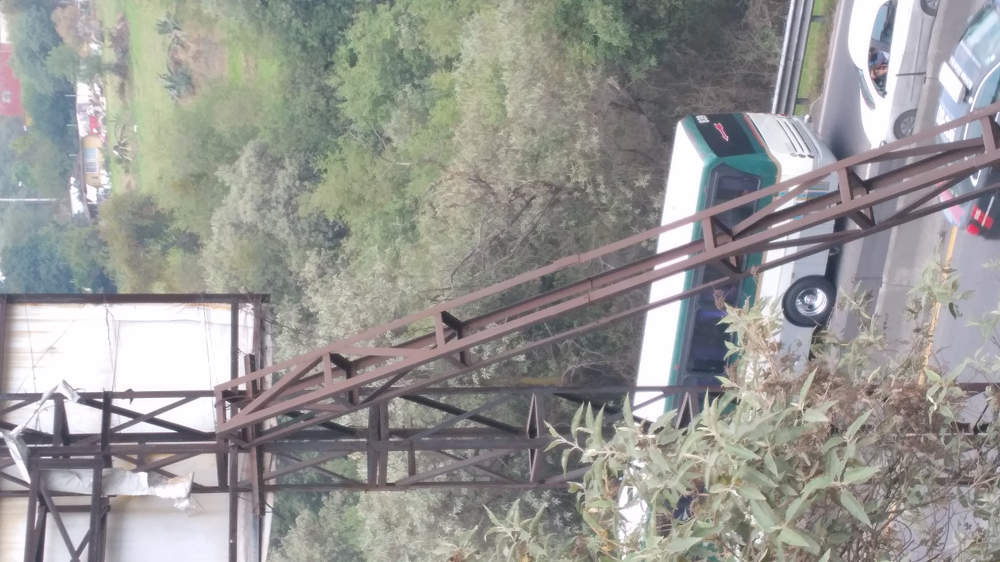

In [ ]:
from IPython import display
display.Image("/content/drive/MyDrive/Test/testcdmx.jpg")

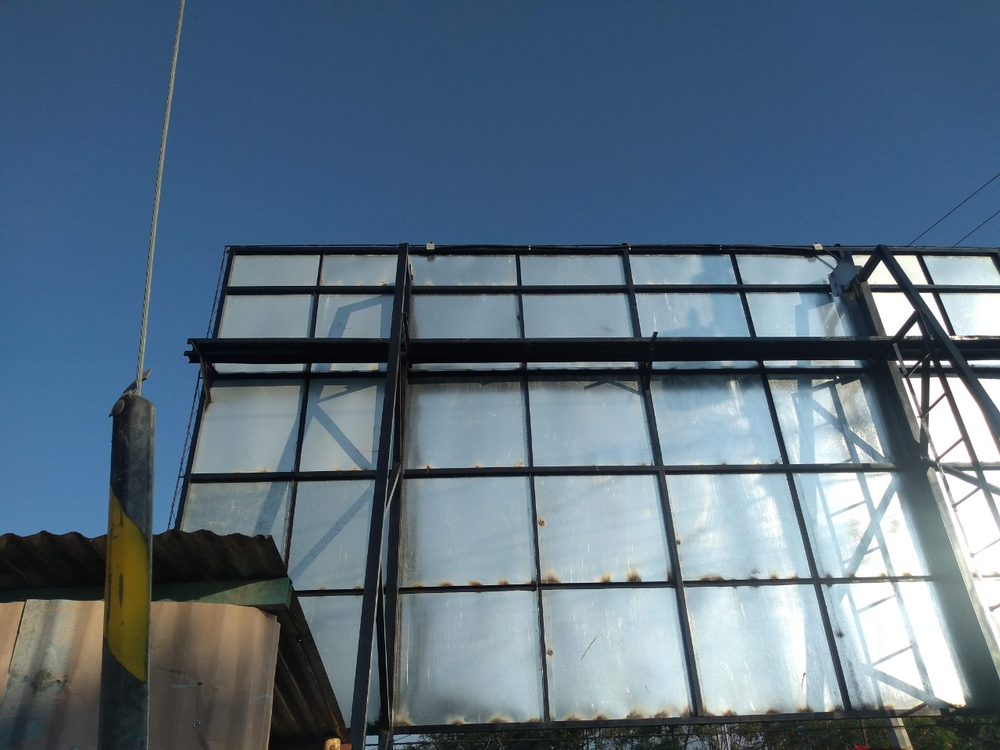

In [ ]:
display.Image("/content/drive/MyDrive/Test/Oaxaca_.jpeg")

##Chossing tipe of metal

In the first steaps of the project we are only consider Iron  

In [ ]:
a = widgets.RadioButtons(
    options=['Select one','Iron'], #Cooper , Aluminium, ..., and other coild be 
                                                                   #considers in other part of the project
    description='Kind of metal:',
    disabled=False
    
)
a

RadioButtons(description='Kind of metal:', options=('Select one', 'Iron'), value='Select one')

In [ ]:
if a.value == 'Cooper':
    base_url = 'There are not data!!!'
    print(base_url)
    
elif a.value == 'Iron':
    base_url = 'training_set'
    print('We have data!!')
    
    
elif a.value == 'Steel':
    base_url = ' There are not data!!!'
    print(base_url)
    

elif a.value == 'Aluminium':
    base_url = 'There are not data!!!'

#Starting the model 

##Export dataset

In [ ]:
path = Path('/content/drive/MyDrive/Deep_Learning')
path.ls()

[PosixPath('/content/drive/MyDrive/Deep_Learning/non_corrosion'),
 PosixPath('/content/drive/MyDrive/Deep_Learning/corrosion'),
 PosixPath('/content/drive/MyDrive/Deep_Learning/models')]

## We going to create our valid set with the 20 % of the dataset

In [ ]:
np.random.seed(42)
data = ImageDataBunch.from_folder(path, train=".", valid_pct=0.2,
        ds_tfms=get_transforms(), size=224, num_workers=4).normalize(imagenet_stats)

##Detect classes in *dataset*

In [ ]:
data.classes

['corrosion', 'non_corrosion']

##Display one part of the batch with the labels 
tree rows in this case 

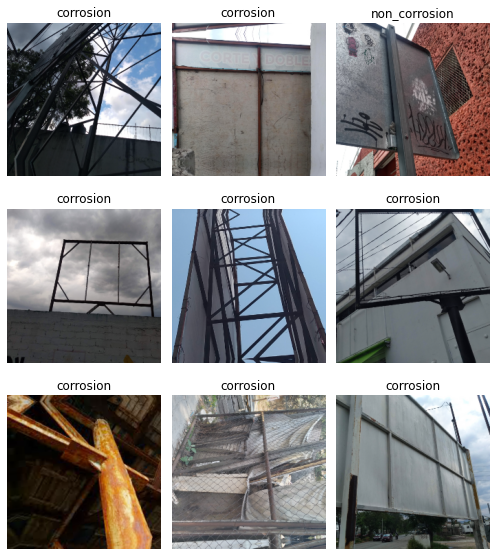

In [ ]:
data.show_batch(rows=3, figsize=(7,8))

All photos was taked with Drone 

In [ ]:
data.classes, data.c, len(data.train_ds), len(data.valid_ds)

(['corrosion', 'non_corrosion'], 2, 179, 44)

#Training the model

##Creating a CNN 
With pre-trained model resnet34

In [ ]:
learn = cnn_learner(data, models.resnet34, metrics=error_rate)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


In [ ]:
learn.fit_one_cycle(5)

epoch,train_loss,valid_loss,error_rate,time
0,1.453718,3.449231,0.727273,01:34
1,1.200045,2.692685,0.704545,01:04
2,0.917092,1.390606,0.522727,01:01
3,0.774628,0.877845,0.295455,01:01
4,0.659397,0.484530,0.204545,01:00


In [ ]:
learn.save('stage-1')

Taking all the dataset with unfreeze command 

In [ ]:
learn.unfreeze()

run the command line of learning rate finder and plot it



In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


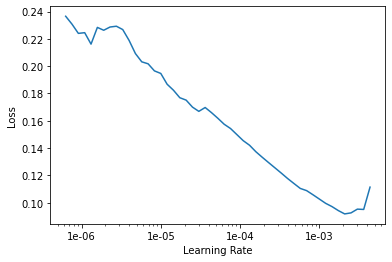

In [ ]:
learn.recorder.plot()

Choose the negative slope (bigger), where the model is training in the best way

In [ ]:
learn.fit_one_cycle(2, max_lr=slice(3e-5,1e-3))

epoch,train_loss,valid_loss,error_rate,time
0,0.210671,0.346863,0.159091,01:02
1,0.150908,0.682855,0.318182,01:04


In [ ]:
learn.save('stage-2')

#How the data is 
#How the training was...

In [ ]:
learn.load('stage-2')

Learner(data=ImageDataBunch;

Train: LabelList (179 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
non_corrosion,non_corrosion,non_corrosion,non_corrosion,non_corrosion
Path: /content/drive/MyDrive/Deep_Learning;

Valid: LabelList (44 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
non_corrosion,corrosion,corrosion,corrosion,corrosion
Path: /content/drive/MyDrive/Deep_Learning;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

#Turn on the model 

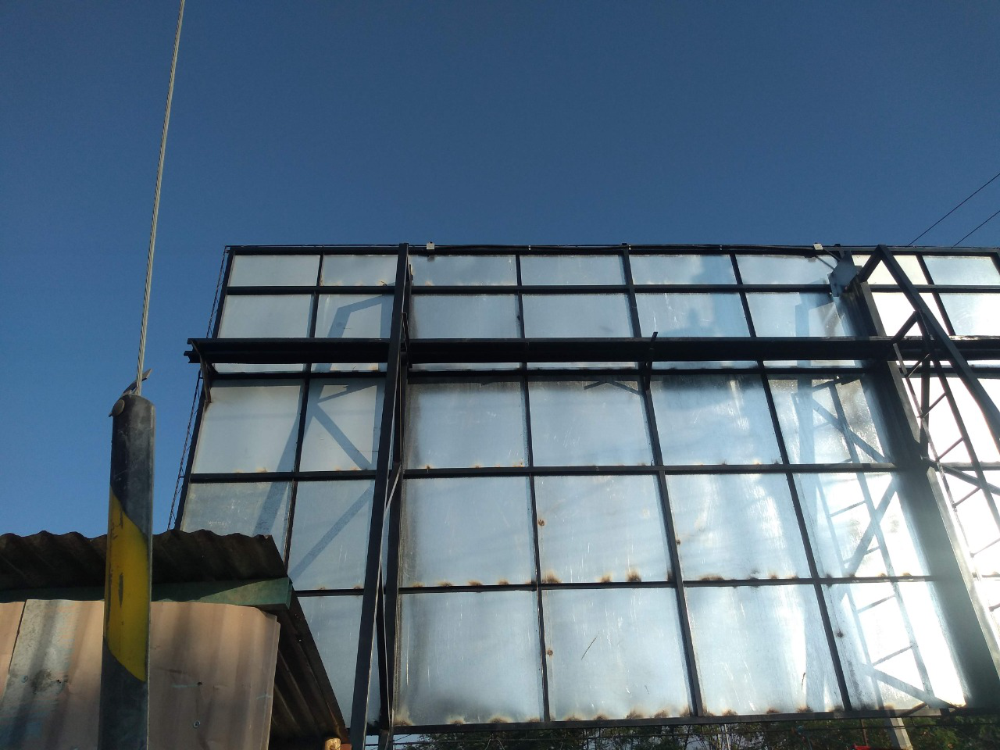

In [ ]:
img = open_image(path/'/content/drive/MyDrive/Test/Oaxaca_.jpeg')
img

In [ ]:
pred_class,pred_idx,outputs = learn.predict(img)
pred_class.obj

'non_corrosion'

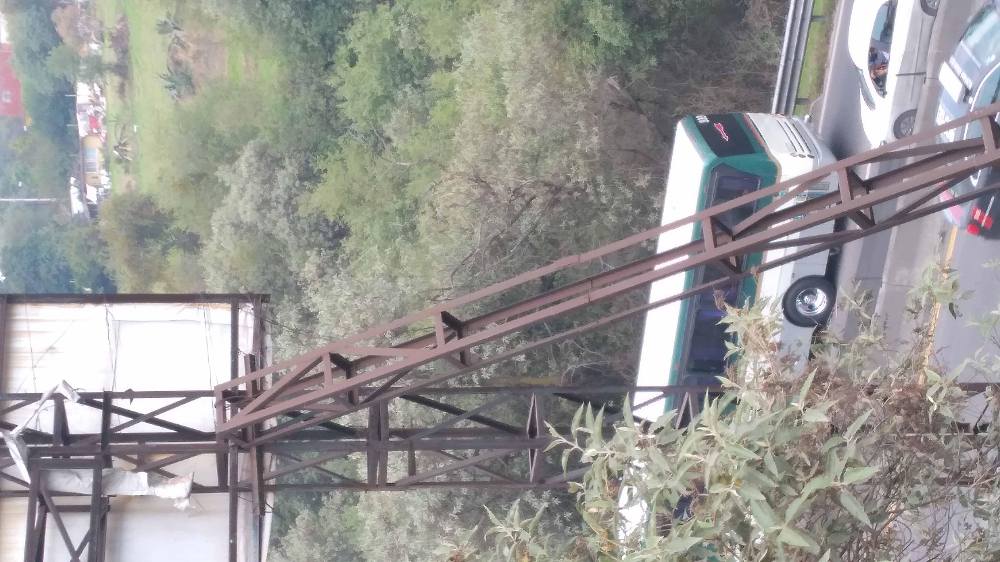

In [ ]:
img1 = open_image(path/'/content/drive/MyDrive/Test/testcdmx.jpg')
img1

In [ ]:
pred_class,pred_idx,outputs = learn.predict(img1)
pred_class.obj

'corrosion'

In [ ]:
!pip install pillow

In [ ]:
import PIL.Image

In [ ]:
!pip install gpsphoto

!pip install ExifRead
!pip install piexif==0.7.1

  Created wheel for gpsphoto: filename=gpsphoto-2.2.3-cp37-none-any.whl size=11869 sha256=b42dce5723b49c6a2c84aa8090cb5a02c3e33704abc52682ddbe1fcfde1c7495
  Stored in directory: /root/.cache/pip/wheels/b7/92/10/14e3a79085c23023c7342a4e19bf7e1a3132dabc3a64cd11c4
Successfully built gpsphoto


In [ ]:

import exifread
# Get the data from image file and return a dictionary


In [ ]:
from GPSPhoto import gpsphoto

In [ ]:
data = gpsphoto.getGPSData('/content/drive/MyDrive/Test/Oaxaca.jpg')
print(data['Latitude'], data['Longitude'])

17.064857 -96.67832802777778


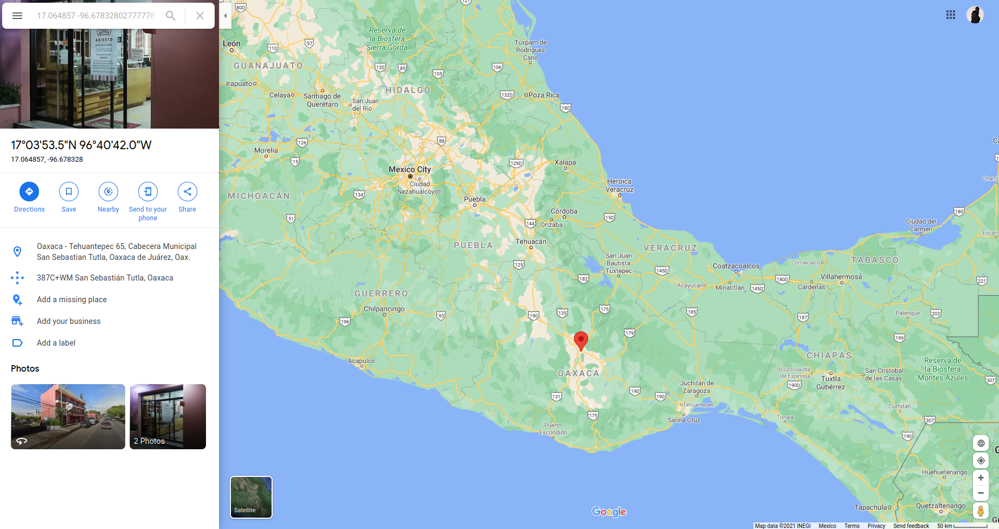

In [ ]:
data = gpsphoto.getGPSData('/content/drive/MyDrive/Test/testcdmx.jpg')
print(data['Latitude'], data['Longitude'])

19.343702777777775 -99.30769444444444


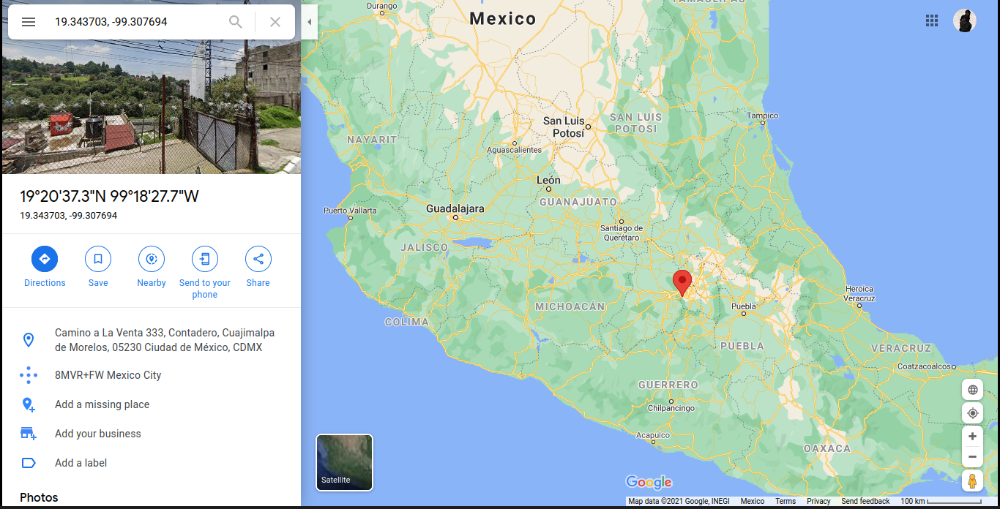

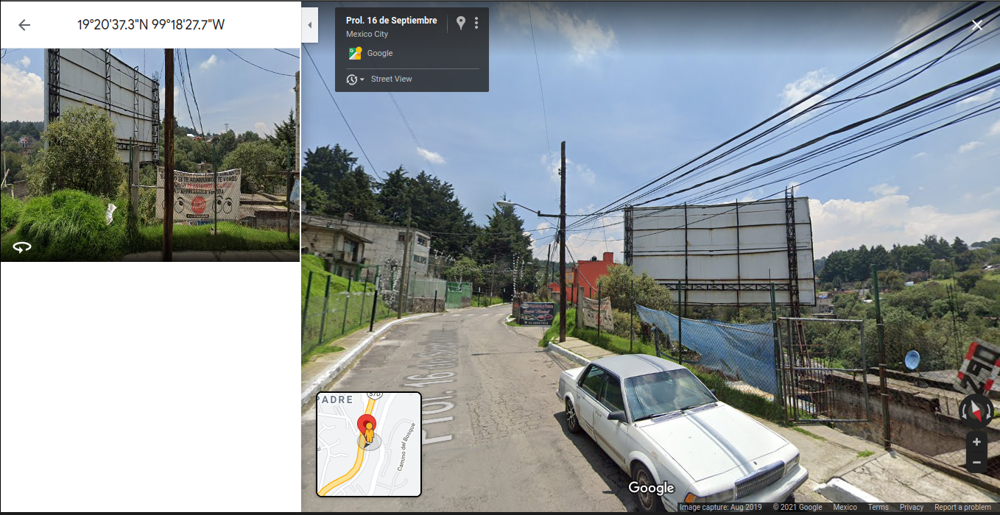